
Data: 28/11/2025 <br>
Autora: Khaoula Ikkene <br>
Grupo: Off-Policry





En esta practica trabajaremos con el entorn 'Taxi-v3' de la librería Gymnasiu.


In [1]:
!pip install gymnasium pygame
!pip install imageio

In [2]:
import gymnasium as gym
import numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict
import matplotlib.animation as animation
import imageio
from IPython.display import HTML
import random
from google.colab import files

**Ejercicio 1 :
Creación y descripción del entorno**


In [4]:
env = gym.make('Taxi-v3', render_mode = "rgb_array")

Visualización del entorno


array([[[110, 109, 106],
        [110, 109, 106],
        [124, 122, 122],
        ...,
        [108, 111, 109],
        [108, 111, 109],
        [118, 119, 119]],

       [[110, 109, 106],
        [110, 109, 106],
        [124, 122, 122],
        ...,
        [108, 111, 109],
        [108, 111, 109],
        [118, 119, 119]],

       [[114, 116, 115],
        [114, 116, 115],
        [126, 127, 126],
        ...,
        [112, 113, 111],
        [112, 113, 111],
        [118, 117, 115]],

       ...,

       [[116, 115, 116],
        [116, 115, 116],
        [106, 107, 108],
        ...,
        [113, 115, 114],
        [113, 115, 114],
        [117, 114, 117]],

       [[116, 115, 116],
        [116, 115, 116],
        [106, 107, 108],
        ...,
        [113, 115, 114],
        [113, 115, 114],
        [117, 114, 117]],

       [[115, 112, 112],
        [115, 112, 112],
        [119, 119, 117],
        ...,
        [123, 119, 118],
        [123, 119, 118],
        [114, 114, 117]]], dtype=uint8)
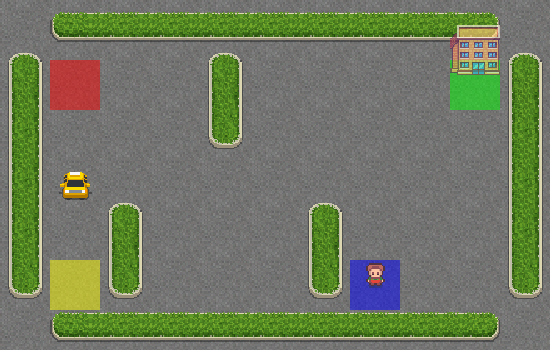

In [5]:
state,_ = env.reset()
env.render()

In [6]:
print("Espacio de observacion: ",env.observation_space)
print("Número de estados del espacio de observación: ",env.observation_space.n)
print("---------------------------------------------------------")
print("Espacio de acciones: ",env.action_space)
print("Número de acciones posibles: ", env.action_space.n)
print("---------------------------------------------------------")


Espacio de observacion:  Discrete(500)
Número de estados del espacio de observación:  500
---------------------------------------------------------
Espacio de acciones:  Discrete(6)
Número de acciones posibles:  6
---------------------------------------------------------


Para obtener información detallada de las recompensas, las posibles acciones que puede realizar el agente, y las condiciones de terminación del episodio, entre otras cosas, consultaremos la propia [documentación](https://gymnasium.farama.org/environments/toy_text/taxi/) del entorno



Las acciones y recompensas definidas para el agente son:


### Tabla de Acciones

| Código | Acción                     |
|--------|---------------------------|
| 0      | Moverse hacia abajo        |
| 1      | Moverse hacia arriba       |
| 2      | Moverse hacia la derecha   |
| 3      | Moverse hacia la izquierda |
| 4      | Recoger al pasajero        |
| 5      | Dejar al pasajero          |

### Tabla de Recompensas

| Situación                         | Recompensa |
|----------------------------------|------------|
| Por paso, a menos que se active otra recompensa                        | -1         |
| Entregar pasajero correctamente    | +20        |
| Recogida o entrega ilegal del pasajero          | -10        |



Los episodios acaban con la finalización de la tasca, es decir el taxi deja al pasajero en la zona destinada, y se truncan si
su longitud es de 200 pasos.

Como primer paso, vamos a definir los hiperparámetros que usaremos.

**Ejercicio 2: Monte Carlo on-policy first-visit Control**

Como primer paso, vamos a definir los hiperparámetros que usaremos.

**Alpha (α)** <br>

Controla la rapidez con la que el agente ajusta sus expectativas sobre las recompensas inmediatas en función de la experiencia recibida.


| Efecto de los Valores de Parámetro|
|-----------------|
| - **α = 1**: El agente aprende rápidamente de la experiencia reciente, pero puede ser más sensible a fluctuaciones y ruidos. |
| - **α = 0**: No se actualizan los valores basados en nuevas experiencias, el aprendizaje es muy lento. |
| - **0 < α < 1**: Ajuste moderado, balance entre estabilidad y rapidez. |
                                                                              




 **Gamma (γ)**  <br>
Define cuánta importancia se le da a las recompensas futuras en relación con las inmediatas. El parámetro determina el descuento aplicado a las recompensas futuras.

| Efecto de los Valores de Parámetro|
|-----------------|
| - **γ = 0**: El agente se enfoca solo en recompensas inmediatas y no tiene en cuenta las consecuencias futuras. |
| - **γ = 1**: El agente planifica a largo plazo, valorando las recompensas futuras igual que las inmediatas. |
| - **0 < γ < 1**: Balance entre recompensas a corto y largo plazo. |

Para la implementación del algoritmo MC first-visit control, necesitamos definir los siguientes metodos auxiliares.

### Métodos auxiliares

|Método| Uso|
|--------|---------------------------|
|generate_episode()| genera un episodio siguiendo una política determinada y devuelve la trayectoria|
|run_episode()| ejecuta un episodio completo de evaluación usando una Q-table con política greedy |
|policy_pi()|selecciona una acción al azar en un estado usando una política determinada|
|argmax_with_randomness|Elige aleatoriamente una de las acciones con el valor máximo según la función Q del estado, resolviendo empates de forma arbitrária para mayor exploración|
|decay_epsilon|implementa un decaimiento lineal del epsilon para balancear exploración vs explotación durante el entrenamiento del agente|
|generate_animation()| genera una animación de un episodio completo a  partir de la tabla Q obtenida, elegiendo en cada estado St la acción At con el mayor valor Q(St,At)|




In [7]:
def generate_episode(env, epsilon, pi):
  trajectory =[]
  state,_= env.reset()
  done = False
  while not done:
    action = policy_pi(env, state, pi, epsilon)
    next_state, reward, terminated, truncated, _ = env.step(action)
    trajectory.append((state, action, reward))
    state = next_state
    done = terminated or truncated
  return trajectory


In [8]:
def run_episode(env, Q_table):
   state, _ = env.reset()
   done = False
   total_reward = 0
   frames = [env.render()]
   while not done:
       action = np.argmax(Q_table[state])
       next_state, reward, terminated, truncated, _ = env.step(action)
       done = terminated or truncated
       frames.append(env.render())
       total_reward += reward
       state = next_state
   return frames, total_reward

In [9]:
def policy_pi(env, state, pi, epsilon):
    if np.random.rand() < epsilon:
        # Devuelve acción aleatoria
        return env.action_space.sample()
    else:
        # Devuelve la acción greedy
        return int(np.argmax(pi[state]))

In [10]:
def argmax_with_randomness(Q, state):
    q_values = Q[state]
    max_value = np.max(q_values)
    return np.random.choice( np.flatnonzero(q_values == max_value))

In [11]:
def decay_epsilon(epsilon):
    final_epsilon=0.1
    epsilon_decay = 0.0001
    epsilon = max(final_epsilon, epsilon - epsilon_decay)
    return epsilon

In [12]:
def generate_animation(env, Q):
  frames, total_reward = run_episode(env, Q)
  fig = plt.figure()
  img = plt.imshow(frames[0])
  def animate(i):
    img.set_data(frames[i])
    return [img]

  ani = animation.FuncAnimation(fig, animate, frames=len(frames), interval=50, blit=True)
  plt.close(fig)
  return HTML(ani.to_jshtml()), frames

Y ahora implementaremos nuestro algoritmo de Monte Carlo first-visit


In [13]:
def MC_onPolicy_first_visit(env, epsilon, gamma, eps):
  Q = defaultdict(lambda: np.zeros(env.action_space.n))
  #pi es una política arbitraria
  pi = np.ones((env.observation_space.n, env.action_space.n)) / env.action_space.n
  returns = defaultdict(list)

  for i in range(eps):
    #generar un episodio siguinedo la política pi
    episode= generate_episode(env, epsilon, pi)
    G = 0
    visited = set()
    for s,a,r in reversed(episode):
      G = gamma*G + r
      if  (s, a) not in visited:
          visited.add((s,a))
          returns[(s,a)].append(G)
          Q[s][a] = np.average(returns[(s,a)])
          best_action = argmax_with_randomness(Q,s)
          for action in range(env.action_space.n):
            if action == best_action:
              pi[s][action] = 1- epsilon + epsilon/env.action_space.n
            else:
              pi[s][action]  = epsilon/env.action_space.n
    epsilon = decay_epsilon(epsilon)
    if i%100==0 :
      print(f" Episode = {i}|G={G} ")
  return Q, pi


In [14]:
Q_mc, policy_mc = MC_onPolicy_first_visit(env, epsilon=1, gamma= 0.99, eps = 100000)


 Episode = 0|G=-361.30867312773825 
 Episode = 100|G=-342.38343958506886 
 Episode = 200|G=-337.4876774494189 
 Episode = 300|G=-388.7636351597919 
 Episode = 400|G=-367.06518344061925 
 Episode = 500|G=-315.21832856663843 
 Episode = 600|G=-353.48356823205665 
 Episode = 700|G=-351.93986794916185 
 Episode = 800|G=-383.19018066331836 
 Episode = 900|G=-329.6769964560504 
 Episode = 1000|G=-319.61773283964516 
 Episode = 1100|G=-347.5631701529697 
 Episode = 1200|G=-345.23159444808056 
 Episode = 1300|G=-128.73372666796865 
 Episode = 1400|G=-292.34585622957655 
 Episode = 1500|G=-345.85502318159683 
 Episode = 1600|G=-189.66514606362537 
 Episode = 1700|G=-286.5061652766908 
 Episode = 1800|G=-224.49447277610324 
 Episode = 1900|G=-239.99577573717775 
 Episode = 2000|G=-285.2494141598384 
 Episode = 2100|G=-237.86806305204544 
 Episode = 2200|G=-281.36666069953895 
 Episode = 2300|G=-308.3499671674603 
 Episode = 2400|G=-283.8142152881008 
 Episode = 2500|G=-152.05235222218303 
 Episo

In [15]:
animation_mc, _= generate_animation(env, Q_mc)
animation_mc

In [16]:
policy_mc

array([[0.16666667, 0.16666667, 0.16666667, 0.16666667, 0.16666667,
        0.16666667],
       [0.01666667, 0.01666667, 0.01666667, 0.01666667, 0.91666667,
        0.01666667],
       [0.01666667, 0.01666667, 0.01666667, 0.01666667, 0.91666667,
        0.01666667],
       ...,
       [0.01666667, 0.01666667, 0.91666667, 0.01666667, 0.01666667,
        0.01666667],
       [0.01666667, 0.91666667, 0.01666667, 0.01666667, 0.01666667,
        0.01666667],
       [0.01666667, 0.01666667, 0.01666667, 0.91666667, 0.01666667,
        0.01666667]])

In [17]:
optimal_policy = np.argmax(policy_mc, axis=1)
optimal_policy

array([0, 4, 4, 4, 0, 0, 3, 0, 0, 0, 0, 4, 1, 3, 4, 0, 5, 0, 0, 0, 0, 3,
       3, 3, 3, 0, 0, 5, 3, 3, 0, 0, 0, 3, 0, 0, 3, 0, 0, 0, 0, 2, 0, 3,
       1, 0, 3, 2, 3, 2, 0, 0, 0, 3, 0, 0, 0, 2, 0, 0, 0, 0, 2, 2, 2, 0,
       2, 2, 0, 2, 0, 0, 0, 0, 3, 0, 3, 2, 5, 0, 0, 3, 0, 0, 4, 0, 4, 4,
       0, 1, 0, 3, 3, 0, 5, 0, 3, 5, 0, 0, 0, 1, 1, 1, 1, 0, 0, 2, 0, 0,
       0, 0, 3, 0, 0, 0, 1, 2, 0, 2, 0, 1, 1, 5, 0, 0, 3, 0, 3, 1, 0, 3,
       3, 5, 0, 0, 1, 0, 3, 0, 0, 0, 0, 2, 0, 0, 2, 2, 0, 0, 0, 1, 3, 2,
       0, 0, 0, 2, 0, 2, 0, 3, 2, 0, 2, 0, 1, 2, 1, 3, 0, 0, 2, 2, 0, 0,
       2, 1, 0, 0, 0, 0, 3, 3, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 3, 0, 3, 1,
       0, 3, 0, 0, 1, 1, 1, 0, 2, 2, 0, 0, 0, 0, 1, 2, 2, 0, 1, 1, 0, 2,
       0, 1, 3, 3, 2, 0, 2, 2, 3, 3, 0, 3, 1, 0, 2, 0, 1, 2, 3, 2, 0, 3,
       3, 2, 2, 0, 1, 1, 0, 3, 0, 3, 1, 1, 2, 0, 3, 1, 3, 2, 0, 1, 3, 2,
       1, 0, 1, 2, 1, 4, 0, 3, 0, 2, 2, 0, 3, 1, 3, 0, 0, 3, 1, 0, 1, 0,
       3, 1, 3, 0, 0, 3, 0, 0, 0, 0, 3, 1, 3, 0, 0,

**Ejercicio 3: Double Q-learning**

El algoritmo Double Q-learning utiliza dos tablas de valores Q independientes (Q1 y Q2) para reducir el sesgo de sobreestimación presente en el Q-learning clásico. En lugar de usar la misma tabla para seleccionar la acción con valor máximo, Double Q-learning alterna entre dos tablas:una para seleccionar la acción otra para y evaluara, lo que mejora la estimación del valor de cada acción.

A continuación, definimos el método choose_action_dql() que , dadas las tablas Q1 y Q2 y un estado state, elige una acción con una política ϵ-greedy.
Con probabilidad ϵ selecciona una acción aleatoria permitiendo la exploración, y con probabilidad 1-ϵ selecciona la acción que maximiza la suma Q1[state, action]+Q2[state, action].

In [18]:
def choose_action_dql(Q_1, Q_2, state, epsilon):
  total_values= []
  total_values = np.array([Q_1[(state, a)] + Q_2[(state, a)] for a in range(env.action_space.n)])
  if np.random.rand()<epsilon:
    return np.random.choice(env.action_space.n)
  else:
    return np.argmax(total_values)


In [19]:
def double_Q_Learning(env, alpha, epsilon,gamma, eps):
  Q_1 =np.zeros((env.observation_space.n, env.action_space.n))
  Q_2= np.zeros((env.observation_space.n, env.action_space.n))
  for i in range(eps):
    state,_ = env.reset()
    done = False
    total_reward= 0
    while not done:
      action = choose_action_dql(Q_1,Q_2,state, epsilon)
      next_state, reward, terminated, truncated,_= env.step(action)
      total_reward+=reward
      if np.random.rand()<0.5:
          Q_1[state][action] += alpha * (reward + gamma * Q_2[next_state][np.argmax(Q_1[next_state])] - Q_1[state][action])
      else:
          Q_2[state][action] += alpha * (reward + gamma * Q_1[next_state][np.argmax(Q_2[next_state])] - Q_2[state][action])
      done = terminated or truncated
      state = next_state
    if i%100 == 0:
          print("episode:{} sum of reward:{}".format(i,total_reward))


  return Q_1, Q_2



In [24]:
Q_1, Q_2 = double_Q_Learning(env,alpha= 0.8, epsilon= 0.1, gamma=0.99, eps= 30000)

episode:0 sum of reward:-443
episode:100 sum of reward:-551
episode:200 sum of reward:-337
episode:300 sum of reward:-171
episode:400 sum of reward:4
episode:500 sum of reward:8
episode:600 sum of reward:12
episode:700 sum of reward:-4
episode:800 sum of reward:-19
episode:900 sum of reward:-30
episode:1000 sum of reward:-7
episode:1100 sum of reward:5
episode:1200 sum of reward:4
episode:1300 sum of reward:9
episode:1400 sum of reward:-3
episode:1500 sum of reward:9
episode:1600 sum of reward:-4
episode:1700 sum of reward:-7
episode:1800 sum of reward:-3
episode:1900 sum of reward:8
episode:2000 sum of reward:2
episode:2100 sum of reward:-1
episode:2200 sum of reward:10
episode:2300 sum of reward:5
episode:2400 sum of reward:6
episode:2500 sum of reward:11
episode:2600 sum of reward:8
episode:2700 sum of reward:10
episode:2800 sum of reward:13
episode:2900 sum of reward:-32
episode:3000 sum of reward:12
episode:3100 sum of reward:1
episode:3200 sum of reward:1
episode:3300 sum of rewa

In [25]:
#Calculamos la tabla Q, resultado de la suma de las tablas Q1 y Q2
Q_table_dql = Q_1+Q_2

Para derivar la política óptima bastaría con elegir en cada estado la acción que maximiza el valor Q(state, action).





In [26]:
policy_dql = np.argmax(Q_table_dql, axis=1)
policy_dql


array([0, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 5, 0, 0, 2, 0, 3,
       3, 3, 0, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 3, 0, 3, 0, 0, 0, 0, 2,
       2, 0, 2, 2, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 2, 0,
       2, 2, 0, 0, 0, 0, 0, 0, 2, 0, 0, 2, 0, 0, 0, 0, 3, 0, 4, 0, 4, 4,
       0, 0, 0, 0, 0, 0, 0, 0, 3, 5, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 2, 2, 2, 0, 1, 2, 0, 0, 0, 3, 1, 1, 0, 0, 0, 0, 3, 3, 0, 3,
       0, 0, 0, 0, 1, 0, 3, 0, 0, 0, 0, 0, 1, 0, 2, 2, 0, 0, 0, 0, 2, 2,
       0, 0, 0, 2, 0, 2, 0, 0, 0, 3, 1, 0, 2, 1, 0, 3, 0, 3, 0, 0, 0, 0,
       0, 1, 3, 0, 0, 0, 3, 3, 1, 0, 1, 1, 0, 3, 0, 0, 0, 0, 0, 0, 3, 1,
       3, 0, 0, 1, 1, 1, 2, 0, 2, 2, 0, 0, 0, 0, 2, 2, 2, 0, 1, 2, 0, 2,
       0, 3, 3, 3, 2, 0, 2, 2, 3, 3, 0, 3, 2, 2, 2, 0, 1, 2, 3, 2, 0, 3,
       3, 3, 1, 0, 1, 2, 3, 3, 0, 3, 2, 2, 2, 0, 3, 1, 3, 2, 0, 3, 3, 3,
       1, 0, 1, 2, 3, 3, 0, 3, 0, 0, 0, 0, 3, 1, 3, 0, 0, 3, 3, 3, 1, 0,
       1, 1, 3, 3, 0, 3, 0, 3, 3, 0, 3, 1, 1, 3, 0,

**Ejercicio 4**

Ejecutaremos un episodio usando la política aprendida por el algoritmo Double Q-learning. Mostratemos la animación y la guardaremos en format .gif

In [27]:
animation_dql, frames= generate_animation(env, Q_table_dql)
animation_dql

Guardaremos la animación en formato .gif

In [29]:
#guardar como gif
imageio.mimsave("DQL-animation.gif", frames, duration= 1.0)
files.download("DQL-animation.gif")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

**Ejercicio 5: n-step SARSA**


Implementaremos el algoritmo de n-step SARSA, para los siguientes valores de n: 1,2,4, 6,8.
En cada episodio, guardaremos la recompensa acumulada y el valor medio del error |\delta\|.

In [30]:
def moving_average(x, w=100):
    out = np.empty_like(x, dtype=float)
    s = 0.0
    k = 0
    for i, v in enumerate(x):
        s += v
        k += 1
        if k > w:
            s -= x[i - w]
            k -= 1
        out[i] = s / k
    return out


In [31]:
def epsilon_greedy_policy(Q, state, epsilon):
  if np.random.rand()<epsilon:
    return np.random.randint(Q.shape[1])
  else:
    return np.argmax(Q[state])


In [44]:

def n_step_sarsa(env,n, alpha, epsilon, gamma, eps):

  Q = np.zeros((env.observation_space.n, env.action_space.n))
  #guardar las recompensas de cada episodio
  episode_rewards = []
  errors_TD = []

  for episode in range(eps):

    T = np.inf
    #tiempo actual
    t = 0

    rewards= [0]
    errors=[]
    error_TD=0
    done = False

    #Inicializar y guardar S0
    state,_= env.reset()
    states=[state]
     #Elegir y guardar acción A0
    action = epsilon_greedy_policy(Q, state, epsilon)
    actions=[action]

    while True:
      if t<T:
        #tomar acción siguiente
        next_state, reward, terminated, truncated,_= env.step(action)
        done = terminated or truncated

        states.append(next_state)
        rewards.append(reward)
        state = next_state
        if done:
          T = t+1
        else:
          next_action = epsilon_greedy_policy(Q, next_state, epsilon)
          actions.append(next_action)
      tau = t-n+1

      if tau >=0:

        G = 0.0
        for i in range(tau + 1, min(tau + n, T)+1):
            G += (gamma ** (i - tau - 1)) * rewards[i]
        if tau + n < T:
            state_action= (states[tau+n], actions[tau+n])
            G += (gamma ** n) * Q[state_action[0]][state_action[1]]

        state_action= (states[tau], actions[tau])
        error_TD = G - Q[state_action[0]][state_action[1]]
        errors.append(error_TD)

        Q[state_action[0]][state_action[1]] += alpha * error_TD

      t+=1
      state= next_state
      action= next_action
      if tau==T-1:
        break

    episode_rewards.append(np.sum(rewards))
    errors_TD.append(np.mean(errors))

  return Q, episode_rewards, errors_TD


In [56]:

n_values = [1, 2, 4, 6, 8]
all_rewards= []
all_td_errros=[]
Q_table_nstepSarsa=[]
for i in range(len(n_values)):
  Q, r, e= n_step_sarsa(env, n_values[i], alpha=0.1, epsilon=0.1, gamma=0.99, eps=100000)

  all_rewards.append(r)
  all_td_errros.append(e)
  Q_table_nstepSarsa.append(Q)






In [57]:
#n=1
animation1, _= generate_animation(env, Q_table_nstepSarsa[0])
animation1


In [58]:
#n=2
animation2, _= generate_animation(env, Q_table_nstepSarsa[1])
animation2

In [59]:
#n= 4
animation3, _= generate_animation(env, Q_table_nstepSarsa[2])
animation3

In [60]:
#n=6
animation4, _= generate_animation(env, Q_table_nstepSarsa[3])
animation4

In [61]:
#n = 8
animation5, _= generate_animation(env, Q_table_nstepSarsa[4])
animation5

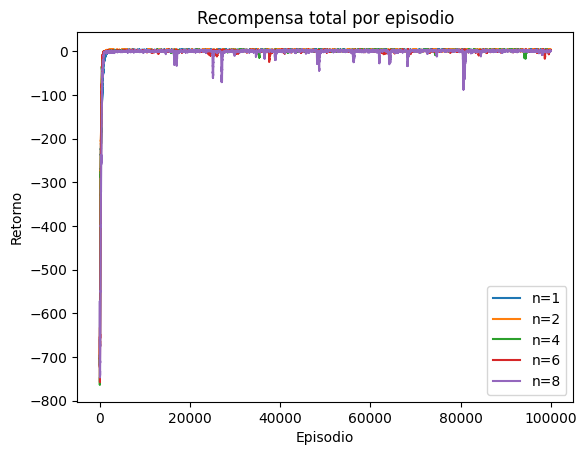

In [62]:
#let's plot the average reward and error TD


# plt.subplot(1,2,1)
for idx, n in enumerate(n_values):
    plt.plot(moving_average(all_rewards[idx]), label=f'n={n}')
plt.title("Recompensa total por episodio")
plt.xlabel("Episodio")
plt.ylabel("Retorno")
plt.legend()


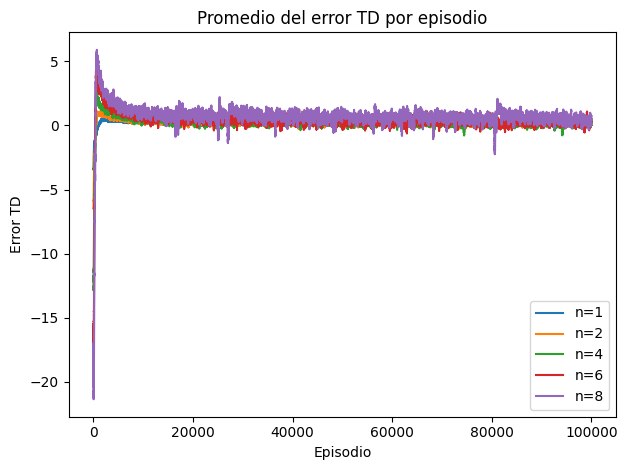

In [63]:
for idx, n in enumerate(n_values):
    plt.plot(moving_average(all_td_errros[idx]), label=f'n={n}')
plt.title("Promedio del error TD por episodio")
plt.xlabel("Episodio")
plt.ylabel("Error TD")
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
#Al acabar cerraremos el entorno
env.close()